#   MODELS

## Mapa

In [3]:
import duckdb
import pandas as pd
import folium
import branca.colormap as cm
import matplotlib.pyplot as plt


# Conexión al archivo de DuckDB
con = duckdb.connect(database='exploitation_zone.duckdb')

# Consultar una tabla específica y cargar los resultados en un DataFrame de pandas
df = con.execute("SELECT * FROM mapa_visualitzacio").fetchdf()

# Cierra la conexión cuando termines
con.close()

In [8]:
df.head()

,ZIPCODE,avg_income_per_zipcode,latitude,longitude
0,96815.0,993218.0,21.270510,-157.800384
1,96815.0,993218.0,21.284324,-157.814114
2,96815.0,993218.0,21.283815,-157.814795
3,96815.0,993218.0,21.280758,-157.827950
4,96815.0,993218.0,21.280567,-157.828139


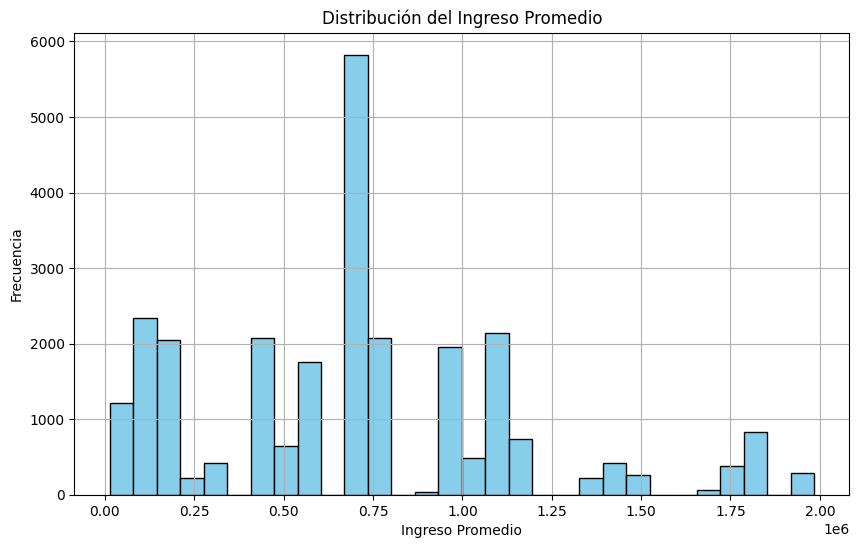

In [5]:
# Histograma de 'average_income'
plt.figure(figsize=(10, 6))
plt.hist(df['avg_income_per_zipcode'], bins=30, color='skyblue', edgecolor='black')
plt.title('Distribución del Ingreso Promedio')
plt.xlabel('Ingreso Promedio')
plt.ylabel('Frecuencia')
plt.grid(True)
plt.show()

In [13]:
# Crear un mapa centrado en una ubicación media
mapa = folium.Map(location=[df['latitude'].mean(), df['longitude'].mean()], zoom_start=10)

# Definir una paleta de colores continua
colorscale = cm.linear.YlOrRd_09.scale(df['avg_income_per_zipcode'].min(), df['avg_income_per_zipcode'].max())


# Añadir puntos al mapa
for _, row in df.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=5,  # Puedes ajustar el tamaño
        fill=True,
        color=colorscale(row['avg_income_per_zipcode']),
        fill_color=colorscale(row['avg_income_per_zipcode']),
        fill_opacity=0.5,
        popup=f"Zipcode: {row['ZIPCODE']}<br>Ingreso promedio: ${row['avg_income_per_zipcode']:.2f}"
    ).add_to(mapa)

colorscale.caption = 'Ingreso Promedio'
colorscale.add_to(mapa)
mapa

## Model Predictiu

In [1]:
import duckdb

# Conexión al archivo de DuckDB
con = duckdb.connect(database='exploitation_zone.duckdb')

# Consultar una tabla específica y cargar los resultados en un DataFrame de pandas
data = con.execute("SELECT * FROM model_predictiu").fetchdf()

# Cierra la conexión cuando termines
con.close()

In [2]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error



data['ZIPCODE'] = pd.to_numeric(data['ZIPCODE'], errors='coerce')
data = data[~data['ZIPCODE'].isna()]
data.head()

# Supongamos que 'zipcode' es la variable que queremos predecir
X = data.drop('ZIPCODE', axis=1)
y = data['ZIPCODE']

# Dividimos los datos en entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Definimos los preprocesadores para variables numéricas y categóricas
numeric_features = X.select_dtypes(include=['int64', 'float64']).columns
categorical_features = X.select_dtypes(include=['object']).columns

numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='mean')),
    ('scaler', StandardScaler())])

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='missing')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))])

# Combinamos los preprocesadores
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)])

# Creamos el pipeline con el preprocesador y el modelo
model = Pipeline(steps=[('preprocessor', preprocessor),
                        ('regressor', LinearRegression())])

# Entrenamos el modelo
model.fit(X_train, y_train)

# Evaluamos el modelo
y_pred = model.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
print("Error cuadrático medio:", mse)

Error cuadrático medio: 2327574039.020375
